## Assignment 5

This assignment is designed to help you understand, implement, and get hold of two important models in Multi-Modal Learning: CLIP and BLIP.

Before starting to code, read the instructions and comments carefully. Make sure you understand the requirements and the expected output.

There are two parts of this assignment.
- Content based image retrieval (CBIR) based on CLIP
- Visual Question Answering (VQA) based on BLIP

## Part 1: Content Based Image Retrieval (CBIR)

Ever found yourself looking for a specific image in a load of photos on your phone?
Imagine you have a system that can retrieve images based on their content. In this assignment, you will implement exactly that.

### Task
1. I have provided a list of images in form of unsplash links. Feel free to explore and add more images.
2. You will have to implement CBIR system that will retrive images based on the query you provide.
3. You have to use CLIP model to extract image and text embeddings. Since CLIP projects both image and text into the same embedding space, similar images and their corresponding text descriptions will be close to each other in the embedding space.
4. You have to use a pretrained CLIP model from HuggingFace. (Because it is not feasible to train CLIP from scratch)
5. You have to use [OpenAI's CLIP](https://huggingface.co/openai/clip-vit-base-patch32) model from HuggingFace. Refer to the page itself and anyother resources you find useful, on how to use it.
6. You will have to take an input query from user, and display the best image matching the query. (You can use cosine similarity to find similarity between the query and the images, then display the image with highest similarity score)

##### Load all the libraries

In [1]:
## Load libraries
from PIL import Image
import requests
import torch
from transformers import CLIPProcessor, CLIPModel
from IPython.display import display


IMAGE_URLS = [
    "https://images.unsplash.com/photo-1750126833705-ba98013f16f3",
    "https://images.unsplash.com/photo-1749627995669-4d4dda3a9c1d",
    "https://images.unsplash.com/photo-1744294724362-3f5c404c771a",
    "https://images.unsplash.com/photo-1750075750236-3f8924fc0e35"
]

# Feel free to edit the above list with your own image URLs

##### Load the CLIP model

In [2]:
model = CLIPModel.from_pretrained("openai/clip-vit-base-patch32")
processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/4.19k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/605M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/605M [00:00<?, ?B/s]

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


preprocessor_config.json:   0%|          | 0.00/316 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/592 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/862k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.22M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/389 [00:00<?, ?B/s]

##### Loop through images, convert then to tensors, and store them in a list

In [3]:
images = [Image.open(requests.get(url, stream=True).raw).convert("RGB") for url in IMAGE_URLS]
inputs = processor(images=images, return_tensors="pt", padding=True)

##### Get the embeddings for the images and store them in a list
Use the CLIP model linked above, the page also provides details on how to use it. If you have any issues with it, feel free to use anyother resources you find useful.

In [4]:
with torch.no_grad():
    image_features = model.get_image_features(**inputs)

##### Get the query from user

In [5]:
query = input("Enter which image are you looking for: ")

Enter which image are you looking for: blue car on the street


##### Get the embeddings for the user query

In [6]:
text_inputs = processor(text=[query], return_tensors="pt", padding=True)
with torch.no_grad():
    text_features = model.get_text_features(**text_inputs)

##### Find the similarity between the query and all the images

In [7]:
similarities = (image_features @ text_features.T).squeeze()
best_match = similarities.argmax().item()

##### Display the image with highest similarity score

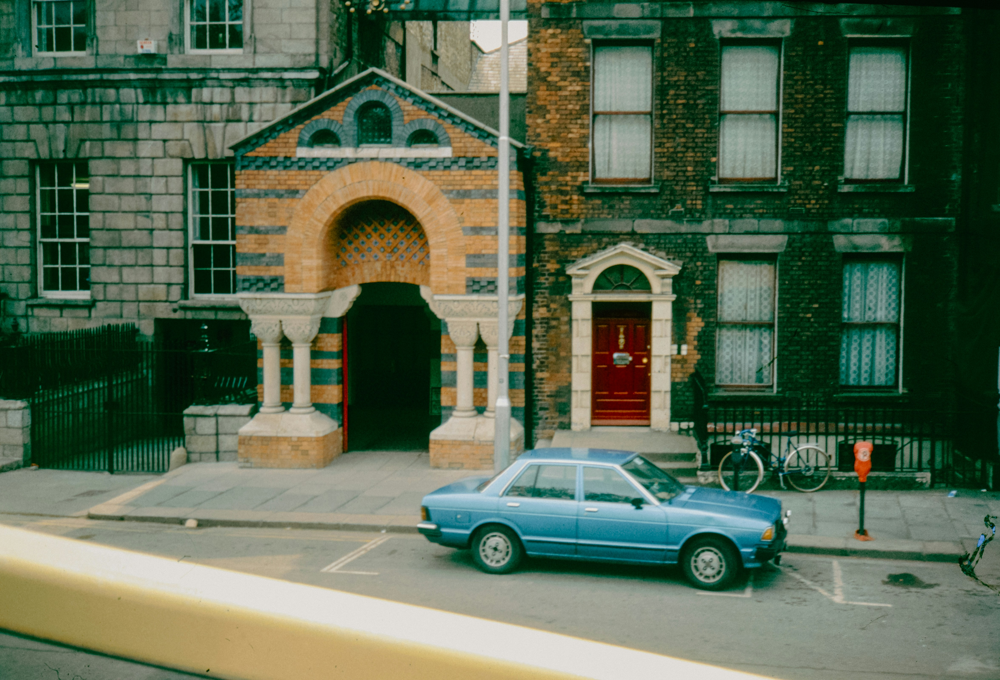

In [8]:
display(images[best_match])

Congrats! You have implemented a simple Content Based Image Retrieval (CBIR) system using CLIP model.

Moving on to the next part of the assignment.

## Part 2: Visual Question Answering (VQA)

This part is based on Visual Question Answering (VQA), where you will be given an image and a question about that image, and you will need to provide an answer.

You are provided with a dataset of 10 images, and a json file containing questions and answers for those images.

### Format of JSON file
```json
[
    "what is the blue shape?",
    "rectangle",
    0
]
```
This means that the question is "what is the blue shape?", the answer is "rectangle", and the image index is 0.
Images are named from 0 to 9, so the image for index 0 is `0.png`.

### Task
1. Load the JSON file and parse the questions and answers.
2. Just for understanding, print a few questions and their corresponding answers, also display the corresponding images. (You may do it for 1 or 2 questions)
3. Implement a function that takes an image and a question, and returns the answer.
4. Run the function on all questions and store the answers in a file. (You can store it in a new JSON or CSV file) (May use pandas for this)
5. Now since you have the answers, you can also evaluate your model. For this, you can compare your answers with the ground truth answers provided in the JSON file. (refer to note below)

Note: But it is not that easy to compare directly, as the answers may not match exactly due to variations in phrasing ("2" and "two", "blue" and "The color is blue". Phrases like this don't match, but are correct). So you should check your answers manually and see if they are correct or not. Do it for first 30 answers, and calculate the accuracy.
There are certain ways to automate this, but they will make this assignment too complicated, so we will not do that here.

### Additional Points
- Refer to BLIP model that was taught in last class. It can be used to answer questions based on images.
- You will have to use pre-trained BLIP model for this task. (Because training it from scratch is not feasible in this assignment)
- You have to use [Salesforce BLIP model](https://huggingface.co/Salesforce/blip-vqa-base) for this task. Refer to the Usage section of page for details on how to use it. If you feel stuck, you can refer to blogs available online, or use AI tools to get yourself familiar with the model.

In [12]:
from google.colab import files
uploaded = files.upload()

Saving filtered_questions.json to filtered_questions.json


1. Load libraries, and the JSON file.

In [14]:
import json
from PIL import Image
import torch
from transformers import BlipProcessor, BlipForQuestionAnswering


processor = BlipProcessor.from_pretrained("Salesforce/blip-vqa-base")
model = BlipForQuestionAnswering.from_pretrained("Salesforce/blip-vqa-base")

with open("filtered_questions.json") as f:
     data = json.load(f)

2. Display a few questions and answers along with images.

Q: what is the blue shape?
A: rectangle


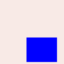

Q: what color is the shape?
A: blue


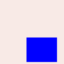

Q: does the image contain a rectangle?
A: yes


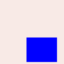

Q: is there a triangle in the image?
A: no


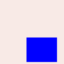

Q: is there a black shape?
A: no


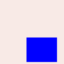

Q: does the image not contain a gray shape?
A: yes


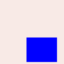

Q: is there a red shape in the image?
A: no


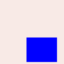

In [15]:
# 3. Example: Display first question, answer, and image
from IPython.display import display
for x in range(7):
    q, a, idx = data[x]
    img = Image.open(f"{idx}.png")
    print("Q:", q)
    print("A:", a)
    display(img)

3. Implement the function to answer questions based on images.

In [ ]:
def vqa(question, image):
    # write code here
    inputs = processor(image, question, return_tensors="pt")
    out = model.generate(**inputs)
    return processor.decode(out[0], skip_special_tokens=True)

4. Run the function on all questions and store the answers in a file.

In [ ]:
results = []
for entry in data:
    question, answer, img_idx = entry
    img = Image.open(f"{img_idx}.png")
    pred = vqa(question, img)
    results.append({"question": question, "ground_truth": answer, "prediction": pred})


In [ ]:
import pandas as pd
df = pd.DataFrame(results)
df.to_csv("vqa_results.csv", index=False)

5. Evaluate the model by comparing answers with ground truth.
Do the comparison manually for the first 30 answers and print the accuracy.

In [ ]:
correct = 22
for i in range(30):
    print(f"Q: {df.iloc[i]['question']}")
    print(f"GT: {df.iloc[i]['ground_truth']}")
    print(f"Pred: {df.iloc[i]['prediction']}")


accuracy = correct / 30
print("Manual Accuracy (first 30):", accuracy)

Q: what is the blue shape?
GT: rectangle
Pred: rectangle
Q: what color is the shape?
GT: blue
Pred: black
Q: does the image contain a rectangle?
GT: yes
Pred: yes
Q: is there a triangle in the image?
GT: no
Pred: no
Q: is there a black shape?
GT: no
Pred: yes
Q: does the image not contain a gray shape?
GT: yes
Pred: yes
Q: is there a red shape in the image?
GT: no
Pred: no
Q: does the image not contain a red shape?
GT: yes
Pred: yes
Q: is there not a blue shape?
GT: no
Pred: yes
Q: is there not a blue shape in the image?
GT: no
Pred: yes
Q: is there not a yellow shape?
GT: yes
Pred: yes
Q: is a teal shape present?
GT: no
Pred: yes
Q: what color is the triangle?
GT: blue
Pred: blue
Q: what color is the shape?
GT: blue
Pred: blue
Q: is there not a rectangle in the image?
GT: yes
Pred: yes
Q: is there a red shape?
GT: no
Pred: no
Q: is there a green shape in the image?
GT: no
Pred: no
Q: is there not a teal shape?
GT: yes
Pred: yes
Q: what shape is in the image?
GT: triangle
Pred: triangl

Bonus: This images were too simple. But guess what? Salesforce has pretrained it's model on wide variety of images, so you can use it on any image of your choice.

Try to load any real world image of any natural scene, or anything you like, and ask questions about it. You will be surprised by the results.

The End 🫡.

If you have any questions, feel free to use following in the given order:
- Google it!!
- ChatGPT
- Ask on the group